# Search Morphological Links on Tarot Card

1. Cropping
2. Description Generation
3. Embedding
4. Metric Learning
5. Visualization
6. Retrieving


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install openai
!pip install git+https://github.com/openai/CLIP.git

In [3]:
import os
import base64
import glob
import random
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from tqdm import tqdm # Show the progress
from openai import OpenAI
from transformers import CLIPProcessor, CLIPModel
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from collections import defaultdict
import umap
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import DBSCAN
from sklearn.metrics.pairwise import euclidean_distances

## Cropping + Description Generation

I used predefined cropping method to crop each image into 40 patches.

And feed each patch into gpt-4o-mini to have the morphological description.

In [4]:
# --- CONFIGURATION ---
DATA_DIR    = '/content/drive/MyDrive/tarot_data'
DEVICE      = 'cuda' if torch.cuda.is_available() else 'cpu'

os.environ["OPENAI_API_KEY"] = ""

# Initialize the new OpenAI client
client = OpenAI()

# The prompt to send to ChatGPT for each patch:
BASE_PROMPT = """
You are an expert in describing visual patterns in symbolic artwork. This image patch is extracted from a tarot card.
Please output only a single, concise English sentence (20–25 words) listing all visible objects, figures, geometric shapes, colors, textures, and their spatial relationships within the patch.
Focus on literal, morphological, and compositional details that can be compared computationally across images.
Do not mention any text, numbers, card names, or symbolic meanings. Avoid subjective or interpretive words.
Do not start with phrases like "The patch features" "The image patch features" etc.
"""

# Define the same 40 regions function
def get_patch_regions(w, h):
    regions = {
        'full_top':        (0, 0, w, h//2),
        'full_bottom':     (0, h//2, w, h),
        'full_left':       (0, 0, w//2, h),
        'full_right':      (w//2, 0, w, h),
        'full_topleft':    (0, 0, w//2, h//2),
        'full_topright':   (w//2, 0, w, h//2),
        'full_bottomleft': (0, h//2, w//2, h),
        'full_bottomright':(w//2, h//2, w, h),
    }
    quad = ['full_topleft','full_topright','full_bottomleft','full_bottomright']
    for key in quad:
        x1,y1,x2,y2 = regions[key]
        qw, qh = x2 - x1, y2 - y1
        prefix = key.split('_')[1]
        regions[f'{prefix}_top']        = (x1, y1, x2, y1+qh//2)
        regions[f'{prefix}_bottom']     = (x1, y1+qh//2, x2, y2)
        regions[f'{prefix}_left']       = (x1, y1, x1+qw//2, y2)
        regions[f'{prefix}_right']      = (x1+qw//2, y1, x2, y2)
        regions[f'{prefix}_topleft']    = (x1, y1, x1+qw//2, y1+qh//2)
        regions[f'{prefix}_topright']   = (x1+qw//2, y1, x2, y1+qh//2)
        regions[f'{prefix}_bottomleft'] = (x1, y1+qh//2, x1+qw//2, y2)
        regions[f'{prefix}_bottomright']= (x1+qw//2, y1+qh//2, x2, y2)
    assert len(regions) == 40, f"Expected 40 patches, got {len(regions)}"
    return regions

# Helper: encode a PIL patch to base64 PNG for OPENAI API
def encode_patch_to_base64(pil_img):
    """
    Takes a PIL Image, converts it to PNG bytes, and returns a base64 data URI string.
    """
    from io import BytesIO
    buffer = BytesIO()
    pil_img.save(buffer, format="PNG")
    b64 = base64.b64encode(buffer.getvalue()).decode("utf-8")
    return f"data:image/png;base64,{b64}"

# Function to call ChatGPT with the image patch embedded as base64
def describe_patch_with_chatgpt(patch: Image.Image) -> str:
    """
    Given a PIL Image patch, encode it to base64 and send to ChatGPT using the new OpenAI client.
    Returns the single-sentence description.
    """
    b64_uri = encode_patch_to_base64(patch)
    prompt = BASE_PROMPT.strip()

    response = client.responses.create(
        model="gpt-4o-mini",
        input=[
            {
                "role": "user",
                "content": [
                    {"type": "input_text", "text": prompt},
                    {"type": "input_image", "image_url": b64_uri},
                ],
            }
        ],
    )
    # Extract and return the assistant’s reply
    return response.output_text.strip()

In [4]:
# Main loop: for each image, for each region, crop, describe, collect
all_records = []  # list of tuples: (filename, region, description)

image_files = glob.glob(os.path.join(DATA_DIR, '*.jpg')) + glob.glob(os.path.join(DATA_DIR, '*.jpeg'))
if not image_files:
    raise FileNotFoundError(f"No image files found in {DATA_DIR}")

print(f"Found {len(image_files)} tarot images. Generating descriptions via OpenAI API gpt-4o-mini..")

for img_path in tqdm(image_files, desc="Images"):
    filename = os.path.basename(img_path)
    img = Image.open(img_path).convert('RGB')
    w, h = img.size
    regions = get_patch_regions(w, h)

    for region_name, (x1, y1, x2, y2) in regions.items():
        patch = img.crop((x1, y1, x2, y2))

        # Call ChatGPT to describe this patch
        try:
            desc = describe_patch_with_chatgpt(patch)
        except Exception as e:
            print(f"Error on {filename} / {region_name}: {e}")
            desc = ""

        # Append to our list
        all_records.append((filename, region_name, desc))

# Save everything into a CSV so no need to regenerate again
df = pd.DataFrame(all_records, columns=["filename", "region", "description"])
output_csv = os.path.join(DATA_DIR, "patch_descriptions.csv")
df.to_csv(output_csv, index=False)
print(f"Wrote {len(df)} rows to {output_csv}")

Found 190 tarot images. Generating descriptions via OpenAI API gpt-4o-mini..


Images: 100%|██████████| 190/190 [4:46:56<00:00, 90.61s/it]

Wrote 7600 rows to /content/drive/MyDrive/tarot_data/patch_descriptions.csv


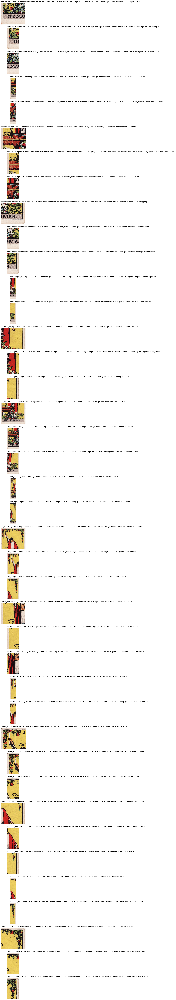

In [6]:
# Load the CSV we generated earlier
csv_path = os.path.join(DATA_DIR, "patch_descriptions.csv")
df = pd.read_csv(csv_path)

# Pick the first image in the CSV and generate its 40 patches for example
first_file = df['filename'].iloc[1]
df_img = df[df['filename'] == first_file]

# Open that image and get its patch coordinates
img_path = os.path.join(DATA_DIR, first_file)
img = Image.open(img_path).convert('RGB')
w, h = img.size
regions = get_patch_regions(w, h)

# Sort the regions in the same order as visualize_patches
sorted_region_names = sorted(regions.keys())
df_img = df_img.set_index('region').loc[sorted_region_names].reset_index()

# Show each patch + description of example image
fig, axes = plt.subplots(len(df_img), 1, figsize=(8, len(df_img)*2.5))

if len(df_img) == 1:
    axes = [axes]
for ax, (_, row) in zip(axes, df_img.iterrows()):
    region = row['region']
    desc = row['description']
    x1, y1, x2, y2 = regions[region]
    patch = img.crop((x1, y1, x2, y2))
    ax.imshow(patch)
    ax.set_title(f"{region}: {desc}", fontsize=12, loc='left')
    ax.axis('off')

plt.tight_layout()
plt.show()

## Embedding

Use CLIP to embed both the image patch and description

In [11]:
# ---- LOAD CLIP ----
from transformers import CLIPProcessor, CLIPModel
import torch
import numpy as np
from PIL import Image
from tqdm import tqdm
import os

# Load normalized CLIP model and processor
clip_model = CLIPModel.from_pretrained("openai/clip-vit-large-patch14").to(DEVICE) # first popular in hugging face,ViT-L/14 Transformer architecture as an image encoder and uses a masked self-attention Transformer as a text encoder
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-large-patch14")

# Configuration
BATCH_SIZE = 64

def get_patch_image_embs(df):
    """
    Extract CLIP image embeddings for each patch in the dataframe.
    """
    patches = []
    for _, row in tqdm(df.iterrows(), total=len(df), desc="Preparing image patches"):
        filename = row['filename']
        region = row['region']

        img_path = os.path.join(DATA_DIR, filename)
        img = Image.open(img_path).convert('RGB')
        w, h = img.size
        regions = get_patch_regions(w, h)

        if region not in regions:
            raise ValueError(f"Region '{region}' not found in image: {filename}")

        x1, y1, x2, y2 = regions[region]
        patch = img.crop((x1, y1, x2, y2))
        patches.append(patch)

    all_embs = []
    for i in tqdm(range(0, len(patches), BATCH_SIZE), desc="Computing image embeddings"):
        batch = patches[i:i+BATCH_SIZE]
        inputs = clip_processor(images=batch, return_tensors="pt").to(DEVICE)
        with torch.no_grad():
            embs = clip_model.get_image_features(**inputs)
            embs = embs / embs.norm(dim=-1, keepdim=True)  # L2 normalize
            embs = embs.cpu().numpy()
        all_embs.append(embs)

    return np.vstack(all_embs)

def get_text_embs(df):
    """
    Extract normalized CLIP text embeddings for each description in the dataframe.
    """
    descs = df['description'].tolist()
    all_embs = []
    for i in tqdm(range(0, len(descs), BATCH_SIZE), desc="Computing text embeddings"):
        batch = descs[i:i+BATCH_SIZE]
        inputs = clip_processor(text=batch, return_tensors="pt", padding=True, truncation=True).to(DEVICE)
        with torch.no_grad():
            embs = clip_model.get_text_features(**inputs)
            embs = embs / embs.norm(dim=-1, keepdim=True)  # L2 normalize
            embs = embs.cpu().numpy()
        all_embs.append(embs)

    return np.vstack(all_embs)



model.safetensors:  34%|###3      | 870M/2.58G [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/905 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/961k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

In [ ]:
# Compute and save patch image embeddings
patch_emb_matrix = get_patch_image_embs(df)
np.save(os.path.join(DATA_DIR, "patch_emb_matrix.npy"), patch_emb_matrix.astype(np.float32))

# Compute and save text description embeddings
desc_emb_matrix = get_text_embs(df)
np.save(os.path.join(DATA_DIR, "desc_emb_matrix.npy"), desc_emb_matrix.astype(np.float32))

In [8]:
patch_emb_matrix = np.load(os.path.join(DATA_DIR, "patch_emb_matrix.npy"))
desc_emb_matrix  = np.load(os.path.join(DATA_DIR, "desc_emb_matrix.npy"))

In [9]:
# Calculate the distance
def cosine_sim(a, b):
    a = a / np.linalg.norm(a, axis=-1, keepdims=True)
    b = b / np.linalg.norm(b, axis=-1, keepdims=True)
    return np.dot(a, b.T)


Here I'm trying to see how the embedding works for our inquiry image patch, compared with image embeddings and descriptions embeddings

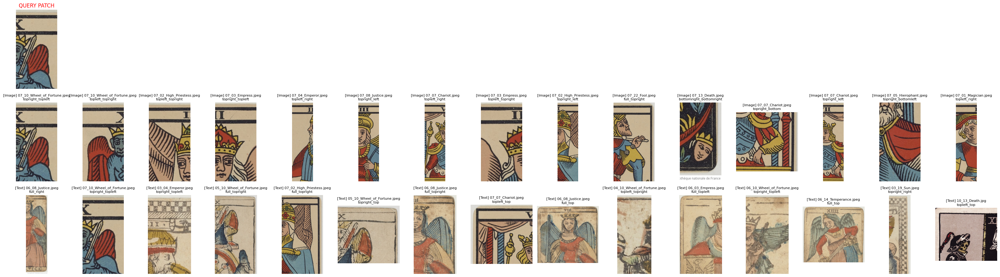


=== Query Patch Description ===
A blue figure with a crown holds a sword with a golden hilt, standing beside a red-striped draped textile against a beige background.

=== Top 15 Text-Similarity Descriptions ===
[1] A figure with a crown and beard wears a red garment, has blue wings, and is outlined in black against a light background with textured surfaces.
[2] A blue figure with a crown holds a sword with a golden hilt, standing beside a red-striped draped textile against a beige background.
[3] A king figure with a yellow crown and red band is positioned to the left, with a black-and-white checkered border above and subtle textures in earthy tones.
[4] A blue figure with a red robe and crown holds a sword, next to a smaller, blue figure, amidst curved lines and various textures on a beige background.
[5] A figure wears a crown and elaborate attire, positioned left, against a textured background with diagonal lines, primarily featuring blue, red, yellow, and earthy tones.
[6] A king 

In [13]:
import matplotlib.pyplot as plt

# ---- Query by filename + region ----
query_filename = '07_10_Wheel_of_Fortune.jpeg'
query_region   = 'topright_topleft'

# Find the row in df matching this filename and region
query_rows = df[(df['filename'] == query_filename) & (df['region'] == query_region)]
assert len(query_rows) == 1, "Query combination must match exactly one row in df!"
query_row = query_rows.iloc[0]
query_desc = query_row['description']

# Crop the query patch
img = Image.open(os.path.join(DATA_DIR, query_filename)).convert('RGB')
w, h = img.size
regions = get_patch_regions(w, h)
x1, y1, x2, y2 = regions[query_region]
query_patch = img.crop((x1, y1, x2, y2))

# Get query patch embedding
inputs = clip_processor(images=query_patch, return_tensors="pt").to(DEVICE)
with torch.no_grad():
    patch_emb = clip_model.get_image_features(**inputs).cpu().numpy()

# Cosine similarity
patch_sim = cosine_sim(patch_emb, patch_emb_matrix)[0]
desc_sim  = cosine_sim(patch_emb, desc_emb_matrix)[0]

# Top-10 indices
top10_patch_idx = np.argsort(-patch_sim)[:15]
top10_desc_idx  = np.argsort(-desc_sim)[:15]

# --- Visualization ---
fig, axes = plt.subplots(3, 15, figsize=(32, 9))

# [A] Query Patch (Row 0, Column 0)
axes[0, 0].imshow(query_patch)
axes[0, 0].set_title("QUERY PATCH", fontsize=12, color='red')
axes[0, 0].set_xlabel(query_desc, fontsize=10, color='red')
axes[0, 0].axis('off')
# Hide the other 9 slots in the row
for i in range(1, 15):
    axes[0, i].axis('off')

# [B] Top 10 image similarity patches (Row 1)
for i, idx in enumerate(top10_patch_idx):
    row = df.iloc[idx]
    filename, region = row['filename'], row['region']
    img = Image.open(os.path.join(DATA_DIR, filename)).convert('RGB')
    w, h = img.size
    regions = get_patch_regions(w, h)
    x1, y1, x2, y2 = regions[region]
    patch = img.crop((x1, y1, x2, y2))
    axes[1, i].imshow(patch)
    axes[1, i].set_title(f"[Image] {filename}\n{region}", fontsize=8)
    axes[1, i].set_xlabel(row['description'], fontsize=8)
    axes[1, i].axis('off')

# [C] Top 10 text similarity patches (Row 2)
for i, idx in enumerate(top10_desc_idx):
    row = df.iloc[idx]
    filename, region = row['filename'], row['region']
    img = Image.open(os.path.join(DATA_DIR, filename)).convert('RGB')
    w, h = img.size
    regions = get_patch_regions(w, h)
    x1, y1, x2, y2 = regions[region]
    patch = img.crop((x1, y1, x2, y2))
    axes[2, i].imshow(patch)
    axes[2, i].set_title(f"[Text] {filename}\n{region}", fontsize=8)
    axes[2, i].set_xlabel(row['description'], fontsize=8)
    axes[2, i].axis('off')

axes[1, 0].set_ylabel("Top 10\nImage\nSimilarity", fontsize=12)
axes[2, 0].set_ylabel("Top 10\nText\nSimilarity", fontsize=12)
plt.tight_layout()
plt.show()

# --- Print Descriptions ---
print("\n=== Query Patch Description ===")
print(query_desc)

print("\n=== Top 15 Text-Similarity Descriptions ===")
for i, idx in enumerate(top10_desc_idx):
    desc = df.iloc[idx]['description']
    print(f"[{i+1}] {desc}")


Image embeddings capture more style info, Description embeddings capture more element info, such as sword, wing, crown here.

## Metric Learning

We want to use triplet loss to pull those initial image embedding towards the morphological description

In [34]:
# For reproducibility
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)

# Load data
df = pd.read_csv(f"{DATA_DIR}/patch_descriptions.csv")
patch_emb_matrix = np.load(f"{DATA_DIR}/patch_emb_matrix.npy")   # shape: [N, D]
desc_emb_matrix  = np.load(f"{DATA_DIR}/desc_emb_matrix.npy")    # shape: [N, D]


In [24]:
all_filenames = df['filename'].unique().tolist()
random.shuffle(all_filenames)
split_idx = int(len(all_filenames) * 0.8)
train_filenames = set(all_filenames[:split_idx])
test_filenames  = set(all_filenames[split_idx:])

train_df = df[df['filename'].isin(train_filenames)].reset_index(drop=True)
test_df  = df[df['filename'].isin(test_filenames)].reset_index(drop=True)
train_patch_emb_matrix = patch_emb_matrix[train_df.index]
test_patch_emb_matrix  = patch_emb_matrix[test_df.index]


In [25]:
def get_patch_key(row):
    position = row['filename'].split('_')[1]
    return f"{position}-{row['region']}"

train_df['patch_key'] = train_df.apply(get_patch_key, axis=1)
patch_key_to_indices = train_df.groupby('patch_key').indices

def cosine_sim(a, b):
    a = a / np.linalg.norm(a, axis=-1, keepdims=True)
    b = b / np.linalg.norm(b, axis=-1, keepdims=True)
    return np.dot(a, b.T)

text_sim_matrix = cosine_sim(train_patch_emb_matrix, train_patch_emb_matrix)

positives_dict = defaultdict(list)
for idx, row in train_df.iterrows():
    key = row['patch_key']
    deck_aligned_indices = [
        i for i in patch_key_to_indices[key]
        if i != idx and train_df.iloc[i]['filename'] != row['filename']
    ]
    text_sim_sorted = np.argsort(-text_sim_matrix[idx])
    text_sim_positives = []
    for j in text_sim_sorted:
        if j == idx or j in deck_aligned_indices:
            continue
        text_sim_positives.append(j)
        if len(text_sim_positives) + len(deck_aligned_indices) >= 20:
            break
    positives = deck_aligned_indices + text_sim_positives
    positives = positives[:20]
    positives_dict[idx] = positives

all_indices = set(range(len(train_df)))
negatives_dict = {
    idx: list(all_indices - {idx} - set(positives_dict[idx]))
    for idx in range(len(train_df))
}


I assembled the positive dataset through two ways, one is deck-aligned(same position, same region, but different deck), the other is text-similar(add the whole positive dataset up to 20 images)

Anchor patch: 10_01_Magician.jpg full_top
Anchor description: A figure wearing a red robe holds a white rod above their head, with an infinity symbol above, surrounded by green foliage and red roses on a yellow background.


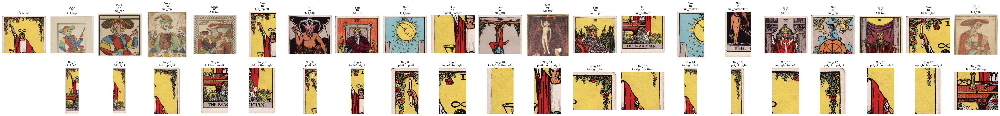

In [29]:
anchor_idx = 0  # Any valid anchor index
anchor_row = train_df.iloc[anchor_idx]
anchor_img = plt.imread(f"{DATA_DIR}/{anchor_row['filename']}")
img = Image.open(f"{DATA_DIR}/{anchor_row['filename']}").convert('RGB')
w, h = img.size
regions = get_patch_regions(w, h)

# Crop anchor patch
x1, y1, x2, y2 = regions[anchor_row['region']]
anchor_patch = img.crop((x1, y1, x2, y2))

print(f"Anchor patch: {anchor_row['filename']} {anchor_row['region']}")
print("Anchor description:", anchor_row['description'])

n_show = 20
fig, axs = plt.subplots(2, n_show+1, figsize=(2*(n_show+1), 5))

# Show anchor
axs[0, 0].imshow(anchor_patch)
axs[0, 0].set_title('Anchor', fontsize=10)
axs[0, 0].axis('off')

# Show positive patches, with distinction between deck-aligned and text-similar
for i, idx in enumerate(positives_dict[anchor_idx][:n_show]):
    row = train_df.iloc[idx]
    img = Image.open(f"{DATA_DIR}/{row['filename']}").convert('RGB')
    w, h = img.size
    regions = get_patch_regions(w, h)
    x1, y1, x2, y2 = regions[row['region']]
    patch = img.crop((x1, y1, x2, y2))

    # check if deck-aligned（same position different deck）
    is_deck_aligned = idx in [
        i for i in patch_key_to_indices[anchor_row['patch_key']]
        if i != anchor_idx and train_df.iloc[i]['filename'] != anchor_row['filename']
    ]
    title_type = "Deck" if is_deck_aligned else "Sim"
    axs[0, i+1].imshow(patch)
    axs[0, i+1].set_title(
        f"{title_type}\n{row['filename'].split('_')[0]}\n{row['region']}",
        fontsize=8
    )
    axs[0, i+1].axis('off')


# Show negative patches
for i, idx in enumerate(negatives_dict[anchor_idx][:n_show]):
    row = train_df.iloc[idx]
    img = Image.open(f"{DATA_DIR}/{row['filename']}").convert('RGB')
    w, h = img.size
    regions = get_patch_regions(w, h)
    x1, y1, x2, y2 = regions[row['region']]
    patch = img.crop((x1, y1, x2, y2))
    axs[1, i+1].imshow(patch)
    axs[1, i+1].set_title(f"Neg {i+1}\n{row['region']}", fontsize=8)
    axs[1, i+1].axis('off')

axs[1, 0].axis('off')
plt.tight_layout()
plt.show()


Here we built up the triplet dataset in two ways:
1. (AllPositiveTripletDataset) positive with 20 negative candidates, and the positive is all listed in the dataset
2. (TarotTripletDataset) everytime select one positive with one negative

In [44]:
class AllPositiveTripletDataset(torch.utils.data.Dataset):
    def __init__(self, emb_matrix, positives_dict, negatives_dict):
        self.emb_matrix = emb_matrix
        self.positives_dict = positives_dict
        self.negatives_dict = negatives_dict
        self.pairs = []
        for anchor_idx, pos_list in positives_dict.items():
            for pos_idx in pos_list:
                self.pairs.append((anchor_idx, pos_idx))
    def __len__(self):
        return len(self.pairs)
    def __getitem__(self, idx):
        anchor_idx, pos_idx = self.pairs[idx]
        anchor_emb = self.emb_matrix[anchor_idx]
        pos_emb = self.emb_matrix[pos_idx]
        neg_candidates = self.negatives_dict[anchor_idx]
        return (
            torch.tensor(anchor_emb, dtype=torch.float32),
            torch.tensor(pos_emb, dtype=torch.float32),
            torch.tensor(neg_candidates, dtype=torch.long),
            torch.tensor(anchor_idx, dtype=torch.long),
        )


In [45]:
class TarotTripletDataset(Dataset):
    def __init__(self, emb_matrix, positives_dict, negatives_dict):
        self.emb_matrix = emb_matrix
        self.positives_dict = positives_dict
        self.negatives_dict = negatives_dict
        self.indices = list(positives_dict.keys())
    def __len__(self):
        return len(self.indices)
    def __getitem__(self, idx):
        anchor_idx = self.indices[idx]
        pos_candidates = self.positives_dict[anchor_idx]
        neg_candidates = self.negatives_dict[anchor_idx]
        if not pos_candidates or not neg_candidates:
            return self.__getitem__((idx + 1) % len(self.indices))
        pos_idx = random.choice(pos_candidates)
        neg_idx = random.choice(neg_candidates)
        anchor_emb = self.emb_matrix[anchor_idx]
        pos_emb = self.emb_matrix[pos_idx]
        neg_emb = self.emb_matrix[neg_idx]
        return (
            torch.tensor(anchor_emb, dtype=torch.float32),
            torch.tensor(pos_emb, dtype=torch.float32),
            torch.tensor(neg_emb, dtype=torch.float32),
        )

class PatchEmbeddingHead(nn.Module):
    def __init__(self, in_dim=768, out_dim=256, hidden_dim=512, num_layers=2):
        super().__init__()
        if num_layers == 1:
            self.mlp = nn.Linear(in_dim, out_dim)
        else:
            self.mlp = nn.Sequential(
                nn.Linear(in_dim, hidden_dim),
                nn.ReLU(inplace=True),
                nn.Linear(hidden_dim, out_dim)
            )
    def forward(self, x):
        z = self.mlp(x)
        z = F.normalize(z, dim=-1)
        return z


For negative groups, we built two ways,
1. (get_hard_negatives_batch) Find top 20 most similar while not positive in batch (only test this)
2. (get_hard_negatives_global) Find top 20 most similar while not positive in global

In [62]:
def get_hard_negatives_batch(anchor_embs, labels, topk=20):
    sim_matrix = torch.matmul(anchor_embs, anchor_embs.T)  # [B, B]
    batch_size = anchor_embs.size(0)
    all_neg_embs = []
    for i in range(batch_size):
        mask = (labels != labels[i])
        masked_sim = sim_matrix[i][mask]
        masked_embs = anchor_embs[mask]
        k = min(topk, masked_embs.size(0))
        if k == 0:
            # fallback: just pick a random other sample
            rand_idx = random.choice([j for j in range(batch_size) if j != i])
            negs = anchor_embs[rand_idx].unsqueeze(0)
            all_neg_embs.append(F.pad(negs, (0, 0, 0, topk-1)))
        else:
            topk_idx = torch.topk(masked_sim, k=k)[1]
            negs = masked_embs[topk_idx]
            # pad if not enough negatives
            all_neg_embs.append(F.pad(negs, (0, 0, 0, topk - k)))
    all_neg_embs = torch.stack(all_neg_embs)  # [B, topk, D]
    return all_neg_embs

def get_hard_negatives_global(anchor_embs, anchor_indices, negatives_dict, emb_matrix, topk=20):
    all_neg_embs = []
    for i, anchor_idx in enumerate(anchor_indices):
        neg_idxs = negatives_dict[anchor_idx.item()]
        anchor_emb = anchor_embs[i].detach().cpu().numpy()
        neg_vecs = emb_matrix[neg_idxs]
        sim = np.dot(anchor_emb, neg_vecs.T) / (
            np.linalg.norm(anchor_emb) * np.linalg.norm(neg_vecs, axis=1))
        k = min(topk, len(sim))
        if k == 0:
            rand_idx = random.choice(list(range(len(emb_matrix))))
            negs = torch.tensor(emb_matrix[rand_idx:rand_idx+1], dtype=torch.float32)
            all_neg_embs.append(F.pad(negs, (0, 0, 0, topk - 1)))
        else:
            topk_idx = np.argsort(sim)[-k:]
            negs = torch.tensor(neg_vecs[topk_idx], dtype=torch.float32)
            all_neg_embs.append(F.pad(negs, (0, 0, 0, topk - k)))
    all_neg_embs = torch.stack(all_neg_embs).to(anchor_embs.device)
    return all_neg_embs


**Multi-negative Triplet Loss (Cosine Distance)**

Given a batch of $B$ anchor-positive pairs $(a_i, p_i)$, for each anchor $a_i$ we select $k$ hardest negatives $n_{i,j}$ ($j = 1,\ldots,k$) within the batch based on cosine similarity. Our training objective minimizes the following multi-negative triplet loss:

$$
L = \frac{1}{B \cdot k} \sum_{i=1}^{B} \sum_{j=1}^{k} \max \left( 0,\; 1 - \cos\left( f(a_i), f(p_i) \right) - \left[ 1 - \cos\left( f(a_i), f(n_{i,j}) \right) \right] + m \right)
$$

where $f(\cdot)$ denotes the normalized embedding function(from embeddinghead), $\cos(\cdot, \cdot)$ is the cosine similarity, and $m$ is the margin. This loss encourages each anchor to be closer to its positive than to any of the $k$ hardest negatives by at least the margin $m$.


In [66]:
def multi_negative_triplet_cosine_loss(anchor_emb, pos_emb, neg_embs, margin=0.2):
    B, topk, D = neg_embs.shape
    anchor_exp = anchor_emb.unsqueeze(1).expand(B, topk, D)
    pos_exp = pos_emb.unsqueeze(1).expand(B, topk, D)
    anchor_flat = anchor_exp.reshape(-1, D)
    pos_flat = pos_exp.reshape(-1, D)
    neg_flat = neg_embs.reshape(-1, D)
    d_ap = 1 - (anchor_flat * pos_flat).sum(dim=-1)
    d_an = 1 - (anchor_flat * neg_flat).sum(dim=-1)
    loss = F.relu(d_ap - d_an + margin)
    loss = loss.view(B, topk).mean()
    return loss


Training

In [94]:
import numpy as np
import torch
from torch.utils.data import DataLoader
import torch.nn.functional as F
from tqdm import tqdm
import datetime
from torch.utils.tensorboard import SummaryWriter



batch_size = 64
num_epochs = 10
topk = 20  # number of hardest negatives

hard_negative_method = 'batch'  # or 'global'
in_dim = train_patch_emb_matrix.shape[1]
train_dataset = AllPositiveTripletDataset(train_patch_emb_matrix, positives_dict, negatives_dict)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
model = PatchEmbeddingHead(in_dim=in_dim, out_dim=256, hidden_dim=512, num_layers=2).to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

# --- TensorBoard setup ---
log_dir = "runs/patch_triplet_" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
writer = SummaryWriter(log_dir)
global_step = 0

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    with tqdm(enumerate(train_loader), total=len(train_loader), desc=f"Epoch {epoch+1}/{num_epochs}") as pbar:
        for batch_idx, (anchor, positive, neg_candidates, anchor_indices) in pbar:
            anchor = anchor.to(DEVICE)
            positive = positive.to(DEVICE)
            anchor_indices = anchor_indices.to(DEVICE)

            # Compute embeddings
            anchor_emb = model(anchor)
            pos_emb = model(positive)

            # Hard negative mining with top-k
            if hard_negative_method == 'batch':
                neg_embs = get_hard_negatives_batch(anchor_emb, anchor_indices, topk=topk)
            else:
                neg_embs = get_hard_negatives_global(anchor_emb, anchor_indices, negatives_dict, train_patch_emb_matrix, topk=topk)

            # Multi-negative triplet loss (using cosine distance)
            loss = multi_negative_triplet_cosine_loss(anchor_emb, pos_emb, neg_embs, margin=0.5)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            avg_loss = running_loss / (batch_idx + 1)

            pbar.set_postfix({'batch_loss': f'{loss.item():.4f}', 'avg_loss': f'{avg_loss:.4f}'})

            # --- Write batch loss to TensorBoard ---
            writer.add_scalar('Loss/Batch', loss.item(), global_step)
            global_step += 1

    avg_epoch_loss = running_loss / len(train_loader)
    print(f"Epoch {epoch+1}/{num_epochs} | Avg Loss: {avg_epoch_loss:.4f}")

    # --- Write epoch loss to TensorBoard ---
    writer.add_scalar('Loss/Epoch', avg_epoch_loss, epoch)

writer.close()


Epoch 1/10: 100%|██████████| 1900/1900 [02:31<00:00, 12.58it/s, batch_loss=0.1814, avg_loss=0.2336]


Epoch 1/10 | Avg Loss: 0.2336


Epoch 2/10: 100%|██████████| 1900/1900 [02:29<00:00, 12.75it/s, batch_loss=0.1966, avg_loss=0.2021]


Epoch 2/10 | Avg Loss: 0.2021


Epoch 3/10: 100%|██████████| 1900/1900 [02:28<00:00, 12.76it/s, batch_loss=0.1996, avg_loss=0.1898]


Epoch 3/10 | Avg Loss: 0.1898


Epoch 4/10: 100%|██████████| 1900/1900 [02:29<00:00, 12.74it/s, batch_loss=0.1572, avg_loss=0.1807]


Epoch 4/10 | Avg Loss: 0.1807


Epoch 5/10: 100%|██████████| 1900/1900 [02:28<00:00, 12.80it/s, batch_loss=0.1880, avg_loss=0.1735]


Epoch 5/10 | Avg Loss: 0.1735


Epoch 6/10: 100%|██████████| 1900/1900 [02:28<00:00, 12.76it/s, batch_loss=0.1690, avg_loss=0.1667]


Epoch 6/10 | Avg Loss: 0.1667


Epoch 7/10: 100%|██████████| 1900/1900 [02:28<00:00, 12.77it/s, batch_loss=0.1473, avg_loss=0.1612]


Epoch 7/10 | Avg Loss: 0.1612


Epoch 8/10: 100%|██████████| 1900/1900 [02:29<00:00, 12.70it/s, batch_loss=0.1581, avg_loss=0.1560]


Epoch 8/10 | Avg Loss: 0.1560


Epoch 9/10: 100%|██████████| 1900/1900 [02:27<00:00, 12.86it/s, batch_loss=0.1436, avg_loss=0.1517]


Epoch 9/10 | Avg Loss: 0.1517


Epoch 10/10: 100%|██████████| 1900/1900 [02:26<00:00, 13.00it/s, batch_loss=0.1425, avg_loss=0.1477]

Epoch 10/10 | Avg Loss: 0.1477


In [95]:
%load_ext tensorboard
%tensorboard --logdir runs


<IPython.core.display.Javascript object>

In [97]:
save_path = "/content/drive/MyDrive/tarot_data/patch_triplet_model.pth"
torch.save(model.state_dict(), save_path)
print(f"Model saved to {save_path}")

Model saved to /content/drive/MyDrive/tarot_data/patch_triplet_model.pth


## Visualization

UMAP for visualization and DBSCAN for clustering

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


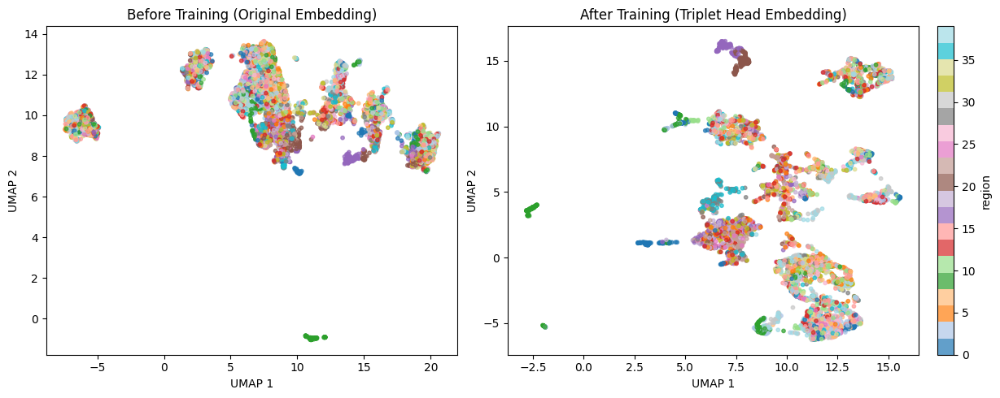

In [108]:


# Encode categorical color label ("region" here) as numbers
le = LabelEncoder()
region_numeric = le.fit_transform(df['region'])
# Get original embeddings
orig_emb = patch_emb_matrix

# Get new embeddings after your trained head
model.eval()
with torch.no_grad():
    batch_size = 512
    all_emb = []
    for i in range(0, len(orig_emb), batch_size):
        batch = torch.tensor(orig_emb[i:i+batch_size], dtype=torch.float32).to(DEVICE)
        emb = model(batch).cpu().numpy()
        all_emb.append(emb)
    new_emb = np.vstack(all_emb)  # shape [N, 256]

# UMAP dimensionality reduction
umap_orig = umap.UMAP(n_components=2, random_state=42).fit_transform(orig_emb)
umap_new  = umap.UMAP(n_components=2, random_state=42).fit_transform(new_emb)

# Plot
def plot_umap(umap1, umap2, color_label, label_names, label_name='region'):
    plt.figure(figsize=(12,5))
    plt.subplot(1,2,1)
    scatter1 = plt.scatter(umap1[:,0], umap1[:,1], c=color_label, cmap='tab20', alpha=0.7, s=10)
    plt.title("Before Training (Original Embedding)")
    plt.xlabel("UMAP 1")
    plt.ylabel("UMAP 2")
    plt.subplot(1,2,2)
    scatter2 = plt.scatter(umap2[:,0], umap2[:,1], c=color_label, cmap='tab20', alpha=0.7, s=10)
    plt.title("After Training (Triplet Head Embedding)")
    plt.xlabel("UMAP 1")
    plt.ylabel("UMAP 2")
    plt.tight_layout()
    cbar = plt.colorbar(scatter2, ax=plt.gcf().get_axes(), label=label_name, orientation='vertical', fraction=0.025, pad=0.02)
    # Show label names on colorbar if not too many
    if len(label_names) <= 20:
        cbar.set_ticks(np.arange(len(label_names)))
        cbar.set_ticklabels(label_names)
    plt.show()

region_names = le.classes_
plot_umap(umap_orig, umap_new, region_numeric, region_names, label_name='region')


==== Clustering & Visualization on ORIGINAL patch embeddings ====


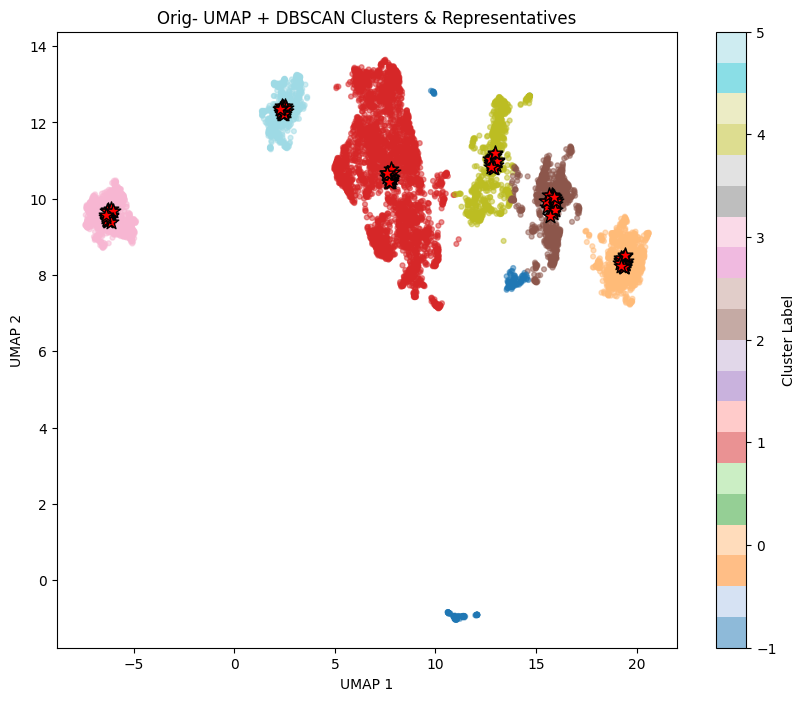


Cluster -1: Noise points (not displayed)


=== Orig-Cluster 0: 879 patches ===


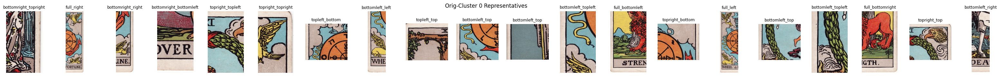

[1] 10_03_Empress.jpg | bottomright_topright | A flowing garment with red, green, and yellow patterns overlaps a grey surface, beside a vertical blue column with cascading water.
[2] 10_10_Wheel_of_Fortune.jpg | full_right | A prominent orange wheel is centered, flanked by a yellow winged lion below, a green serpent-like figure on the left, and a yellow bird above.
[3] 10_10_Wheel_of_Fortune.jpg | bottomright_right | A red figure with flowing elements occupies the upper-left, while a yellow figure with wings and a scepter-like object rests on a gray base strip.
[4] 10_06_Lovers.jpg | bottomright_bottomleft | A brown leg emerges from green grass, with red and blue abstract shapes in the background, alongside a textured cream surface below.
[5] 10_21_World.jpg | topright_topleft | A green, textured vine twists diagonally, emerging from a red object; a pale blue background supports a cloud-like white shape with orange highlights.
[6] 10_10_Wheel_of_Fortune.jpg | topright_topright | A yell

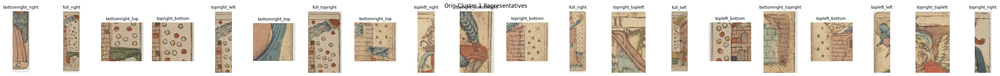

[1] 06_08_Justice.jpeg | bottomright_right | A red-haired figure draped in a pink robe with vertical lines stands beside blue, fan-like fabric textures and a light-colored background.
[2] 05_16_Tower.jpeg | full_right | A textured beige background contains a vertical brown brick wall on the left, a green patch at the bottom, and various colored circles scattered throughout.
[3] 05_16_Tower.jpeg | bottomright_top | A textured light background features red and yellow circles arranged in rows, a grid pattern of dark lines, green patches, and smooth, rounded shapes.
[4] 05_16_Tower.jpeg | topright_bottom | A textured background contains clustered circles in white, yellow, red, and blue, alongside a checkered border with red, green, and beige squares.
[5] 05_16_Tower.jpeg | topright_left | Green and brown rectangular forms are stacked, a wavy green line intersects, and circles in red, blue, and yellow are scattered above a beige background.
[6] 06_14_Temperance.jpeg | bottomright_top | A cu

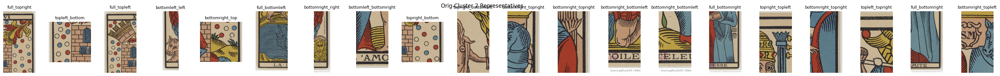

[1] 07_16_Tower.jpeg | full_topright | A red and yellow floral design occupies the upper left, while red, blue, and white circles are scattered across a beige background, adjacent to a brick pattern.
[2] 07_16_Tower.jpeg | topleft_bottom | A textured beige background houses a tan brick structure with arched blue windows, alongside a vertical arrangement of alternating blue, red, and white circular dots.
[3] 07_16_Tower.jpeg | full_topleft | A yellow and brown crown with jagged edges sits atop a brick structure with blue arches, surrounded by alternating red, blue, and white dots.
[4] 07_21_World.jpeg | bottomleft_left | A brown cartoonish cow's head is positioned leftward, with curved lines forming the face, surrounded by blue and red stylized feathers above against a beige background.
[5] 07_16_Tower.jpeg | bottomright_top | A red figure with a blue garment stands next to a textured brick wall; grassy hills in yellowed green contrast with round red, blue, and white dots.
[6] 07_18_Moo

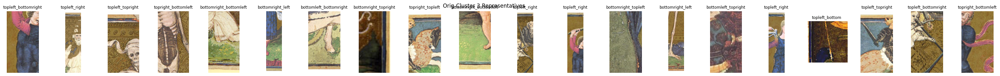

[1] 01_11_Strength.jpg | topleft_bottomright | A person wearing a red top and blue pants is positioned centrally against a textured gold background, with the arms raised and partially obscured by blue fabric.
[2] 01_05_Hierophant.jpg | topleft_right | A figure with a long white beard and brown cloak stands to the left, facing right, against a patterned gold background, holding a white object.
[3] 01_13_Death.jpg | topleft_topright | A skeleton with a hooded cloak occupies the left side, set against an ornate patterned background in gold, with blue and faded reddish details.
[4] 01_13_Death.jpg | topright_bottomleft | A skeletal figure with a ribcage and spine is centrally placed against a textured golden background, featuring swirling patterns in earthy tones and intricate details.
[5] 01_10_Wheel_of_Fortune.jpg | bottomright_bottomleft | A white garment drapes over green grass, with a yellow lotus flower in the foreground, and a dark blue horizontal line below.
[6] 01_14_Temperance.jp

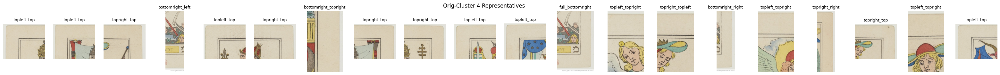

[1] 09_05_Hierophant.jpeg | topleft_top | A gold crown atop a curved headpiece with a cross, surrounded by floral motifs, set against a textured off-white background and bordered by a thin black line.
[2] 09_02_High_Priestess.jpeg | topleft_top | A light blue curtain drapes between red and black pillars, topped with a gold ring, against a beige background with subtle textures.
[3] 09_01_Magician.jpeg | topright_top | A light brown background contains an oval shape in blue outlined in yellow, a blue sphere, and a diagonal brown staff with white stripes.
[4] 09_13_Death.jpeg | bottomright_left | A red diagonal rod intersects with a blue curved form; a blonde head emerges from gray, surrounded by green leaves and hands reaching upwards.
[5] 09_04_Emperor.jpeg | topleft_top | An ornate gold fleur-de-lis sits to the left, adjacent to a detailed figure with a red helmet and facial features, on a cream background.
[6] 09_04_Emperor.jpeg | topright_top | A crowned head with a red and gold crow

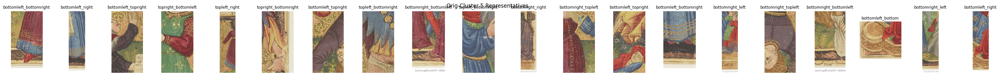

[1] 02_19_Sun.jpeg | bottomleft_bottomright | A red-hemmed garment drapes over blue fabric, revealing a patterned brown stripe beneath, with small circular shapes and green texture in the background.
[2] 02_09_Hermit.jpeg | bottomleft_right | A blue vertical-striped robe with a golden trim at the hem, partially obscured black shoes, and visible red detailing above the shoes.
[3] 02_18_Moon.jpeg | bottomleft_topright | A figure with a face upturned holds a golden spiral, wearing a dark robe with red accents, against a green background with foliage and a white sheet.
[4] 02_11_Strength.jpeg | topright_bottomleft | A green textured background features a partially visible red ornate sleeve, adorned with intricate patterns and gold accents, alongside a light-colored hand.
[5] 02_21_World.jpeg | topleft_right | A figure in a long, burgundy dress holds a stick in a decorated gold and swirling pattern background, with blue accents at the bottom.
[6] 02_22_Fool.jpeg | topright_bottomright | A v

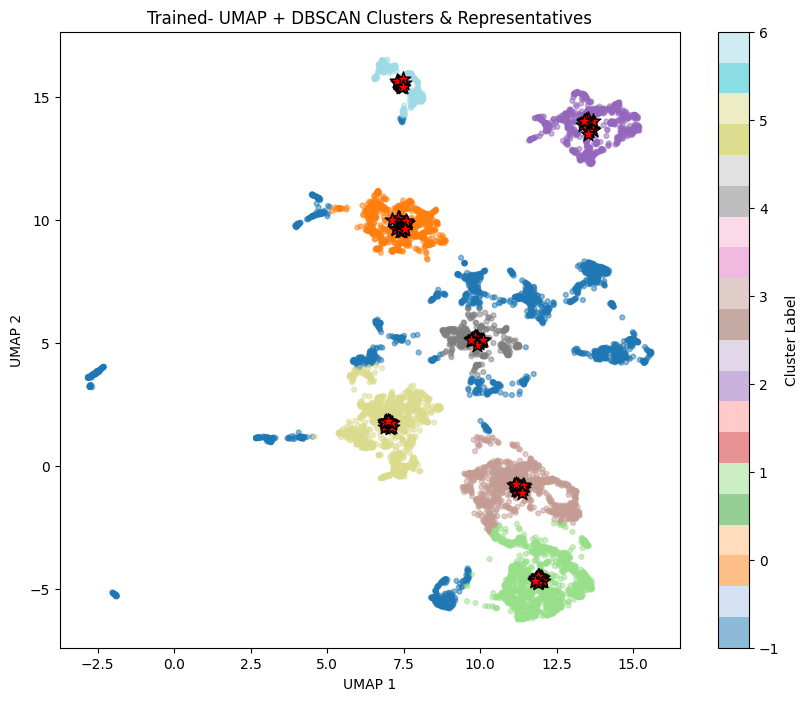


Cluster -1: Noise points (not displayed)


=== Trained-Cluster 0: 718 patches ===


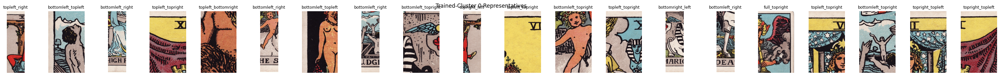

[1] 10_12_Hanged_Man.jpg | topleft_right | A red figure with a blue garment sits beside a textured brown tree, against a light background with faint patterns and a black horizontal line above.
[2] 10_20_Judgement.jpg | bottomleft_topleft | A profile of a person with dark hair stands on a textured base, framed by mountains in the background and a small tree beside water.
[3] 10_02_High_Priestess.jpg | bottomleft_right | A flowing blue robe drapes down, accompanied by a yellow crescent shape, and both sit over a textured gray surface with black lettering.
[4] 10_08_Justice.jpg | topleft_topright | Yellow rectangular area at top, below red wave-like shapes with dark lines, and yellow geometric figure on red background; textures appear smooth and patterned.
[5] 10_15_Devil.jpg | topleft_bottomright | A dark, spiky figure rises from a textured, wavy ground in front of a vertically striped orange background, creating a stark contrast.
[6] 10_19_Sun.jpg | bottomleft_right | A nude figure with

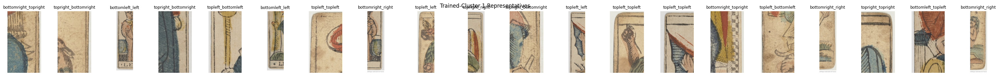

[1] 06_03_Empress.jpeg | bottomright_topright | A blue circular shape is positioned to the left, bordered by light brown jagged lines and a textured beige background with reddish elements at the top.
[2] 06_10_Wheel_of_Fortune.jpeg | topright_bottomright | A blurred figure with elongated limbs and round features occupies the left side, surrounded by a textured beige background and bordered by dark lines.
[3] 05_15_Devil.jpeg | bottomleft_left | A standing figure with brown and peach textures occupies the left, partially overlapping a green and blue striped background, with a dark textured base below.
[4] 05_09_Hermit.jpeg | topright_bottomright | A close-up of a dark blue garment, a hand with a pale yellow glove, and a partially visible reddish sleeve, all against a off-white background.
[5] 05_04_Emperor.jpeg | topleft_bottomleft | A tall, cylindrical, yellow object with vertical lines stands above a circular base, adjacent to a dark blue figure outlined in black.
[6] 05_12_Hanged_Man

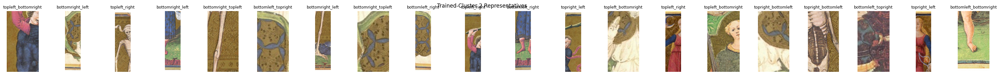

[1] 01_11_Strength.jpg | topleft_bottomright | A person wearing a red top and blue pants is positioned centrally against a textured gold background, with the arms raised and partially obscured by blue fabric.
[2] 01_05_Hierophant.jpg | bottomright_left | A brown textured area with dark spots and three blue stylized shapes intersects with green curved lines against a light background.
[3] 01_13_Death.jpg | topleft_right | A skeletal figure stands against a textured, patterned background in earthy tones, with geometric shapes and swirls surrounding the figure’s head and shoulders.
[4] 01_14_Temperance.jpg | bottomright_left | A blue garment with gold stars drapes over a green grassy area, where a foot with a pink shoe stands on a brown, textured surface.
[5] 01_13_Death.jpg | bottomright_topleft | A slender, elongated white figure on a textured gold background, with diamond and triangular patterns in emerging shades of brown and cream.
[6] 01_05_Hierophant.jpg | bottomleft_topright | A h

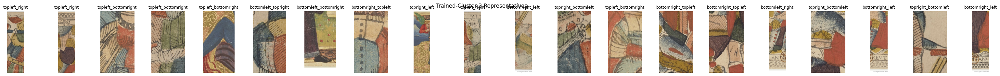

[1] 05_22_Fool.jpeg | topleft_right | Two figures wearing flowing garments of red, green, yellow, and blue, with distinct lines, overlap against a textured background featuring circular and angular shapes.
[2] 03_02_High_Priestess.jpeg | topleft_right | A blue diagonal shape overlays a yellow triangular area, with a brown circular object partially overlapping a textured brown region; linear patterns create depth.
[3] 06_08_Justice.jpeg | topleft_bottomright | A red figure with curved lines is partially overlapping a beige area, surrounded by blue and light colored geometric shapes and textured, diagonal lines in varying shades.
[4] 05_09_Hermit.jpeg | topleft_bottomright | Red, green, and blue shapes in layered patterns, outlined with black lines, exhibit various textures including smooth and rough, arranged closely with intersecting angles.
[5] 02_12_Hanged_Man.jpeg | topleft_bottomright | Curved blue and red shapes overlap with brown and gold striped patterns, set against a textured 

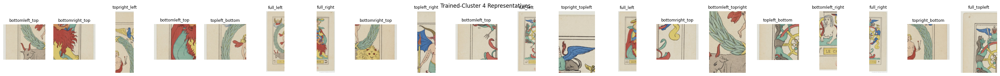

[1] 09_21_World.jpeg | bottomleft_top | A brown bull with curved red horns sits at the bottom left, while a green laurel crown arcs above, intersecting with a figure draped in a red cloth.
[2] 09_11_Strength.jpeg | bottomright_top | A red lion with flowing mane and sharp teeth is positioned above a yellow tail, against a blue and cream background, with textured brushstrokes.
[3] 09_21_World.jpeg | topright_left | A human figure with blonde hair holds two wands, surrounded by green foliage, topped with a bluebird exhibiting yellow wings above them.
[4] 09_11_Strength.jpeg | bottomleft_top | A red-haired figure with a beard is partially visible, draped in a turquoise garment, against a light beige background, showcasing smooth, flat colors and flowing lines.
[5] 09_21_World.jpeg | topleft_bottom | A blonde figure with flowing hair and a red cape stands against a light beige background, surrounded by green, leaf-like shapes and light blue clouds.
[6] 09_21_World.jpeg | full_left | A cheru

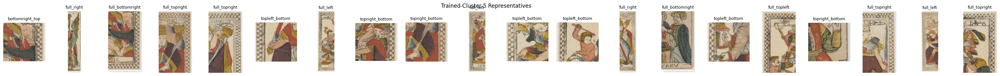

[1] 03_16_Tower.jpeg | bottomright_top | A brightly colored patch includes multiple angular shapes, a wavy texture in yellow and red, and a checkered border with black and white squares.
[2] 04_09_Hermit.jpeg | full_right | A green figure with feathered wings stands beside a red and yellow robe, holding a yellow staff against a textured cream background with faint horizontal lines.
[3] 03_16_Tower.jpeg | full_bottomright | Two figures with light skin tones are intertwined among red, green, and yellow shapes, set against a checkered border with blue and white textures.
[4] 03_02_High_Priestess.jpeg | full_topright | A seated figure wearing a crown is flanked by geometric shapes, with a checkerboard pattern at the edge, featuring red, yellow, brown, and blue colors.
[5] 03_14_Temperance.jpeg | full_topright | A hand holds a golden crown, surrounded by vibrant red and yellow fabric, with a checkerboard pattern along the edge and textured skin tones.
[6] 03_03_Empress.jpeg | topleft_bottom

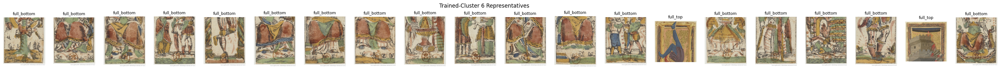

[1] 04_10_Wheel_of_Fortune.jpeg | full_bottom | A central green tree with a brown trunk extends upward, surrounded by brown soil, small green plants, and a circular figure above, partially obscured.
[2] 04_02_High_Priestess.jpeg | full_bottom | Two brown shapes with curved tops sit adjacent on a green background, surrounded by swirling lines in various colors, with floral accents below.
[3] 04_04_Emperor.jpeg | full_bottom | Two seated figures with brown legs and yellow skirts, green hands, and black accents, surrounded by blue and green shapes, with a circular element below.
[4] 04_17_Star.jpeg | full_bottom | Two figures stand side by side, each in colorful garments of red, green, and white, against a textured beige background with a green base.
[5] 04_12_Hanged_Man.jpeg | full_bottom | A human leg, adorned with striped stockings and yellow shoes, is positioned centrally between two vertical striped columns in green and brown.
[6] 04_03_Empress.jpeg | full_bottom | A seated figure dr

In [126]:
def show_umap_with_cluster_reps(umap_emb, df, DATA_DIR, n_per_cluster=10, title_prefix=''):
    dbscan = DBSCAN(eps=1.2, min_samples=330)
    cluster_labels = dbscan.fit_predict(umap_emb)
    df = df.copy()
    df['dbscan_cluster'] = cluster_labels

    # Annotate all the points（different cluster with different colors）
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(umap_emb[:, 0], umap_emb[:, 1], c=cluster_labels, cmap='tab20', s=12, alpha=0.5)
    plt.title(f"{title_prefix} UMAP + DBSCAN Clusters & Representatives")
    plt.xlabel("UMAP 1")
    plt.ylabel("UMAP 2")

    # use red star to mark 10 closest to each cluster centroid
    for c in sorted(set(cluster_labels)):
        if c == -1:
            continue
        cluster_df = df[df['dbscan_cluster'] == c]
        emb = umap_emb[cluster_df.index.values]
        centroid = emb.mean(axis=0, keepdims=True)
        dists = euclidean_distances(emb, centroid).flatten()
        closest_idx = np.argsort(dists)[:n_per_cluster]
        show_indices = cluster_df.index.values[closest_idx]
        plt.scatter(umap_emb[show_indices, 0], umap_emb[show_indices, 1],
                    marker='*', s=120, c='red', edgecolor='black', label=f'Cluster {c} reps' if c == 0 else None)

    plt.colorbar(scatter, label='Cluster Label')
    plt.show()

    # 3. output image and description
    for c in sorted(set(cluster_labels)):
        if c == -1:
            print(f"\nCluster {c}: Noise points (not displayed)\n")
            continue

        cluster_df = df[df['dbscan_cluster'] == c]
        print(f"\n=== {title_prefix}Cluster {c}: {len(cluster_df)} patches ===")

        emb = umap_emb[cluster_df.index.values]
        centroid = emb.mean(axis=0, keepdims=True)
        dists = euclidean_distances(emb, centroid).flatten()
        closest_idx = np.argsort(dists)[:n_per_cluster]
        show_indices = cluster_df.index.values[closest_idx]

        fig, axes = plt.subplots(1, n_per_cluster, figsize=(2*n_per_cluster, 2.5))
        if n_per_cluster == 1:
            axes = [axes]
        for i, idx in enumerate(show_indices):
            row = df.loc[idx]
            filename, region = row['filename'], row['region']
            img = Image.open(f"{DATA_DIR}/{filename}").convert('RGB')
            w, h = img.size
            regions_map = get_patch_regions(w, h)
            x1, y1, x2, y2 = regions_map[region]
            patch = img.crop((x1, y1, x2, y2))
            axes[i].imshow(patch)
            axes[i].set_title(f"{region}", fontsize=9)
            axes[i].axis('off')
        plt.suptitle(f"{title_prefix}Cluster {c} Representatives")
        plt.show()

        for i, idx in enumerate(show_indices):
            row = df.loc[idx]
            print(f"[{i+1}] {row['filename']} | {row['region']} | {row['description']}")

# --- Original embedding ---
print("==== Clustering & Visualization on ORIGINAL patch embeddings ====")
show_umap_with_cluster_reps(umap_orig, df, DATA_DIR, n_per_cluster=20, title_prefix='Orig-')

# --- After training embedding ---
print("\n==== Clustering & Visualization on TRAINED patch embeddings ====")
show_umap_with_cluster_reps(umap_new, df, DATA_DIR, n_per_cluster=20, title_prefix='Trained-')


We found the initial is too close to each other about style level, and not semantic pattern level features. However, the after training one we have more diverse patterns and acrossing different deck more than the first one.

## Patch Image Retreival

The application of our method

Query patch info:
filename                                                                                                                        07_08_Justice.jpeg
region                                                                                                                             topright_bottom
description    A male figure is dressed in red and blue garments, with gold detailing, holding a scale, set against a yellow and lined background.
Name: 737, dtype: object

Top 10 most similar patches in test set (different images):
[1] 01_02_High_Priestess.jpg | topleft_bottom | A cloaked figure stands centrally, with a pale face, surrounded by intricate, gold-patterned backgrounds featuring geometric shapes and dark borders.
[2] 06_02_High_Priestess.jpeg | full_topright | A figure with a red and blue garment, wearing glasses, has white hair flowing, with yellow and red fabric swirling in the top right corner.
[3] 10_07_Chariot.jpg | full_topright | A blue curtain with white sta

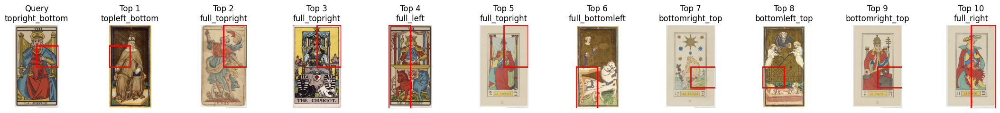

In [106]:
# Extract all test patch embeddings through the trained head
model.eval()
with torch.no_grad():
    all_test_emb = []
    for i in range(0, len(test_patch_emb_matrix), 512):
        batch = torch.tensor(test_patch_emb_matrix[i:i+512], dtype=torch.float32).to(DEVICE)
        emb = model(batch).cpu().numpy()
        all_test_emb.append(emb)
    all_test_emb = np.vstack(all_test_emb)

# Choose a random test patch as query
query_idx = random.randint(0, len(test_df) - 1)
query_patch_emb = all_test_emb[query_idx:query_idx+1]
sim = cosine_sim(query_patch_emb, all_test_emb)[0]

query_filename = test_df.iloc[query_idx]['filename']
sorted_idx = np.argsort(-sim)

# Get top 10 different images (exclude query image)
top_idx = []
used_filenames = set([query_filename])
for idx in sorted_idx:
    fname = test_df.iloc[idx]['filename']
    if fname not in used_filenames:
        top_idx.append(idx)
        used_filenames.add(fname)
    if len(top_idx) == 10:
        break

print("Query patch info:")
pd.set_option('display.max_colwidth', None)
print(test_df.iloc[query_idx][['filename', 'region', 'description']])

print("\nTop 10 most similar patches in test set (different images):")
for i, idx in enumerate(top_idx):
    print(f"[{i+1}] {test_df.iloc[idx]['filename']} | {test_df.iloc[idx]['region']} | {test_df.iloc[idx]['description']}")

# Visualize
import matplotlib.patches as patches

fig, axs = plt.subplots(1, 11, figsize=(22, 2.5))
for i, idx in enumerate([query_idx] + list(top_idx)):
    row = test_df.iloc[idx]
    img_path = f"{DATA_DIR}/{row['filename']}"
    img = Image.open(img_path).convert('RGB')
    w, h = img.size
    regions = get_patch_regions(w, h)
    x1, y1, x2, y2 = regions[row['region']]
    axs[i].imshow(img)
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=2, edgecolor='red', facecolor='none')
    axs[i].add_patch(rect)
    axs[i].set_title(f"{'Query' if i == 0 else f'Top {i}'}\n{row['region']}")
    axs[i].axis('off')
plt.tight_layout()
plt.show()

